In [236]:
import dask.dataframe as dd
import pandas as pd
import numpy as np
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from sklearn.pipeline import Pipeline
import math
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn import metrics
from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn import svm
from sklearn.model_selection import RandomizedSearchCV
import altair
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
import graphviz
from sklearn import tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import roc_curve, auc, roc_auc_score
from sklearn.preprocessing import OneHotEncoder

https://www.kaggle.com/aaronschlegel/austin-animal-center-shelter-outcomes-and/data

This is a dataset of cats in an animal shelter in Austin, Texas. The dataset gives details about each cat and what happens to them while at the shelter. There are nine possible outcomes. A cat can be adopted, returned to its owner, transferred to a different shelter, die, be disposed, be euthanized, go missing, receive an RTO-adoption, or have no outcome. Using the given for each cat, it can be predicted what will happen to this cat once it is in the shelter.

## Cleaning the data to use only relevant columns

In [237]:
catdata = pd.read_csv('/home/students/longca04/DS420/aac_shelter_cat_outcome_eng.csv')

In [238]:
originalcatdata = pd.read_csv('/home/students/longca04/DS420/aac_shelter_cat_outcome_eng.csv')

In [239]:
catdata.head()

,age_upon_outcome,animal_id,animal_type,breed,color,date_of_birth,datetime,monthyear,name,outcome_subtype,...,outcome_weekday,outcome_hour,breed1,breed2,cfa_breed,domestic_breed,coat_pattern,color1,color2,coat
0,2 weeks,A684346,Cat,domestic shorthair,orange,2014-07-07 00:00:00,2014-07-22 16:04:00,2014-07-22T16:04:00,NaN,Partner,...,Tuesday,16,domestic shorthair,NaN,False,True,tabby,orange,NaN,orange
1,1 month,A685067,Cat,domestic shorthair,blue /white,2014-06-16 00:00:00,2014-08-14 18:45:00,2014-08-14T18:45:00,Lucy,NaN,...,Thursday,18,domestic shorthair,NaN,False,True,tabby,blue,white,blue
2,3 months,A678580,Cat,domestic shorthair,white/black,2014-03-26 00:00:00,2014-06-29 17:45:00,2014-06-29T17:45:00,*Frida,Offsite,...,Sunday,17,domestic shorthair,NaN,False,True,NaN,white,black,white
3,1 year,A675405,Cat,domestic mediumhair,black/white,2013-03-27 00:00:00,2014-03-28 14:55:00,2014-03-28T14:55:00,Stella Luna,NaN,...,Friday,14,domestic mediumhair,NaN,False,True,NaN,black,white,black
4,3 weeks,A670420,Cat,domestic shorthair,black/white,2013-12-16 00:00:00,2014-01-09 19:29:00,2014-01-09T19:29:00,NaN,Partner,...,Thursday,19,domestic shorthair,NaN,False,True,NaN,black,white,black


In [240]:
catdata = catdata[['outcome_age_(days)','breed','outcome_type','sex_upon_outcome','sex',
                   'Spay/Neuter','breed1','breed2','domestic_breed','coat_pattern','color1','color2']]

In [241]:
catdata.head()

,outcome_age_(days),breed,outcome_type,sex_upon_outcome,sex,Spay/Neuter,breed1,breed2,domestic_breed,coat_pattern,color1,color2
0,14,domestic shorthair,Transfer,Intact Male,Male,No,domestic shorthair,NaN,True,tabby,orange,NaN
1,30,domestic shorthair,Adoption,Intact Female,Female,No,domestic shorthair,NaN,True,tabby,blue,white
2,90,domestic shorthair,Adoption,Spayed Female,Female,Yes,domestic shorthair,NaN,True,NaN,white,black
3,365,domestic mediumhair,Return to Owner,Spayed Female,Female,Yes,domestic mediumhair,NaN,True,NaN,black,white
4,21,domestic shorthair,Transfer,Intact Male,Male,No,domestic shorthair,NaN,True,NaN,black,white


In [242]:
values = {'outcome_type': 'No Outcome', 'coat_pattern': 'No Pattern', 'color2': 'No 2nd Color', 'breed2': 'No 2nd Breed'}

In [243]:
catdata = catdata.fillna(value=values)

In [244]:
catdata.head()

,outcome_age_(days),breed,outcome_type,sex_upon_outcome,sex,Spay/Neuter,breed1,breed2,domestic_breed,coat_pattern,color1,color2
0,14,domestic shorthair,Transfer,Intact Male,Male,No,domestic shorthair,No 2nd Breed,True,tabby,orange,No 2nd Color
1,30,domestic shorthair,Adoption,Intact Female,Female,No,domestic shorthair,No 2nd Breed,True,tabby,blue,white
2,90,domestic shorthair,Adoption,Spayed Female,Female,Yes,domestic shorthair,No 2nd Breed,True,No Pattern,white,black
3,365,domestic mediumhair,Return to Owner,Spayed Female,Female,Yes,domestic mediumhair,No 2nd Breed,True,No Pattern,black,white
4,21,domestic shorthair,Transfer,Intact Male,Male,No,domestic shorthair,No 2nd Breed,True,No Pattern,black,white


In [245]:
alloutcomes = list(catdata.outcome_type)

In [246]:
outcomelist = []
for i in alloutcomes:
    if i not in outcomelist:
        outcomelist.append(i)

In [247]:
outcomelist

['Transfer',
 'Adoption',
 'Return to Owner',
 'Died',
 'Euthanasia',
 'Missing',
 'Disposal',
 'Rto-Adopt',
 'No Outcome']

This is a list of all the possible outcomes of the cats that live in the shelter. The data on each cat will be used to predict what will happen to it.

In [248]:
encodedcatdata = catdata

In [249]:
labelencoder = LabelEncoder()
encodedcatdata['breed'] = labelencoder.fit_transform(encodedcatdata['breed'])
encodedcatdata['outcome_type'] = labelencoder.fit_transform(encodedcatdata['outcome_type'])
encodedcatdata['sex_upon_outcome'] = labelencoder.fit_transform(encodedcatdata['sex_upon_outcome'])
encodedcatdata['sex'] = labelencoder.fit_transform(encodedcatdata['sex'])
encodedcatdata['Spay/Neuter'] = labelencoder.fit_transform(encodedcatdata['Spay/Neuter'])
encodedcatdata['breed1'] = labelencoder.fit_transform(encodedcatdata['breed1'])
encodedcatdata['breed2'] = labelencoder.fit_transform(encodedcatdata['breed2'])
encodedcatdata['domestic_breed'] = labelencoder.fit_transform(encodedcatdata['domestic_breed'])
encodedcatdata['coat_pattern'] = labelencoder.fit_transform(encodedcatdata['coat_pattern'])
encodedcatdata['color1'] = labelencoder.fit_transform(encodedcatdata['color1'])
encodedcatdata['color2'] = labelencoder.fit_transform(encodedcatdata['color2'])

In [250]:
encodedcatdata.head()

,outcome_age_(days),breed,outcome_type,sex_upon_outcome,sex,Spay/Neuter,breed1,breed2,domestic_breed,coat_pattern,color1,color2
0,14,26,8,1,1,0,17,0,1,6,26,0
1,30,26,0,0,0,0,17,0,1,6,6,18
2,90,26,0,3,0,1,17,0,1,0,38,2
3,365,22,6,3,0,1,16,0,1,0,2,18
4,21,26,8,1,1,0,17,0,1,0,2,18


Every column in the dataframe, except outcome_age_(days), was label encoded to give values. Also, the outcome_age_(days) column is the only numeric column. Everything else is categorical.

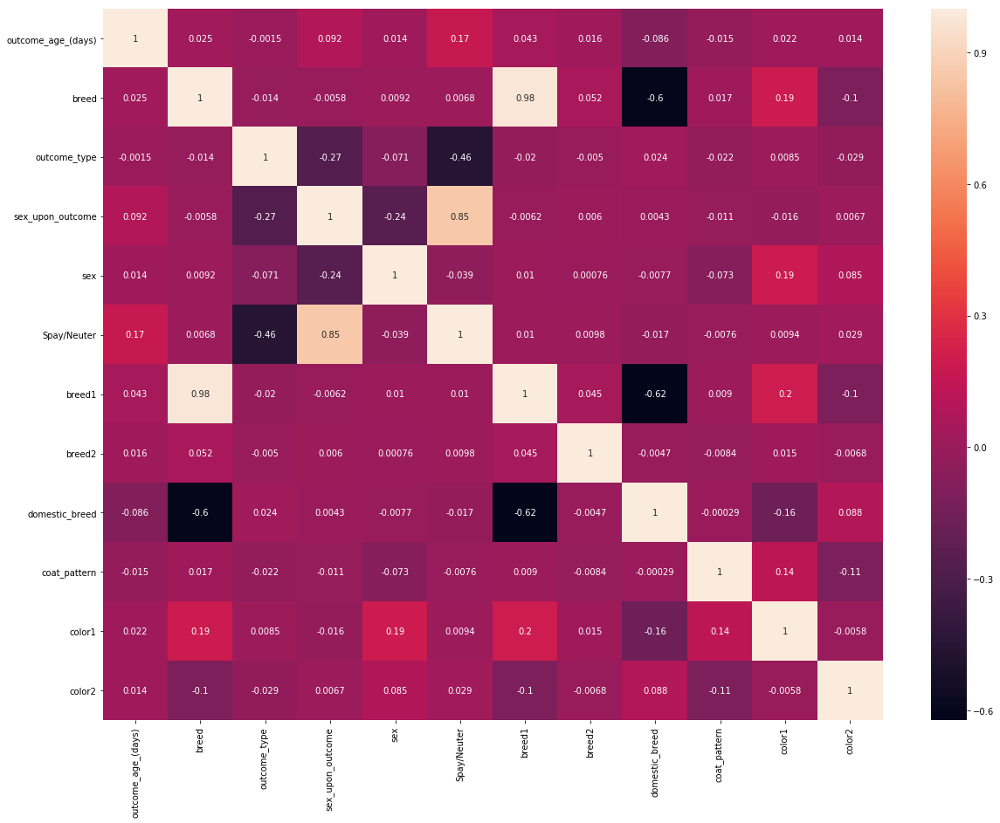

In [251]:
plt.subplots(figsize=(20,15))
sns.heatmap(encodedcatdata.corr(), annot=True)

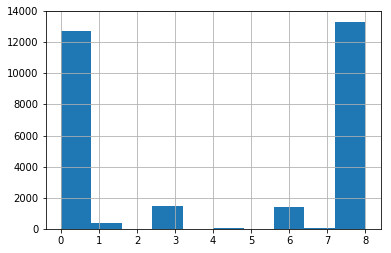

In [252]:
encodedcatdata['outcome_type'].hist()

This is a simple histogram that shows the number of occurances for each particular outcome. Transfer is the most common outcome, followed by adoption. These are the two most common by far. Euthanasia and return to owner are the next two most common occurances. Every outcome does occur, even though it does not appear this way in the histogram.

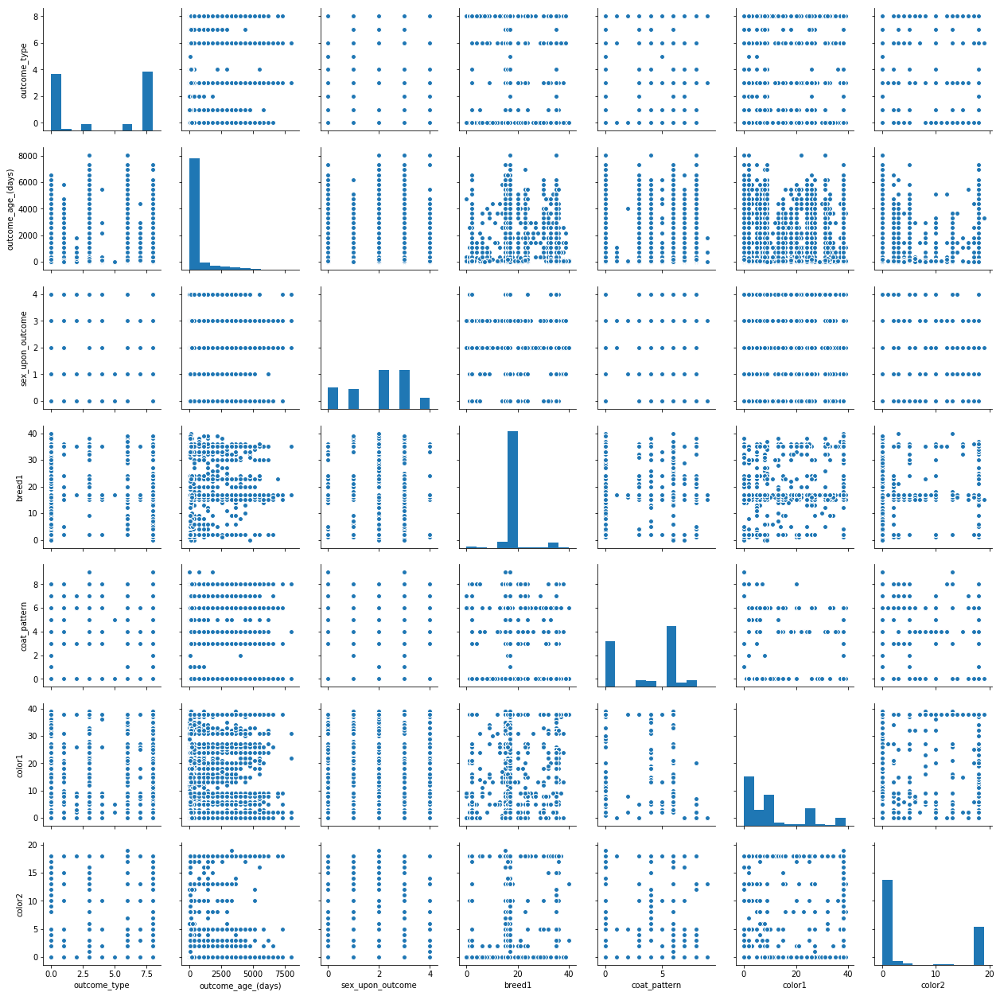

In [253]:
sns.pairplot(encodedcatdata[['outcome_type','outcome_age_(days)','sex_upon_outcome','breed1','coat_pattern','color1','color2']])

In the pairplot of the data, it is difficult to find any correltation because there are so many datapoints. Two relations I did find are that the columns that have a higher age are more likely to have euthanasia or return to owner as the outcome. Also, there seems to be a certain breed of cats that has two colors.

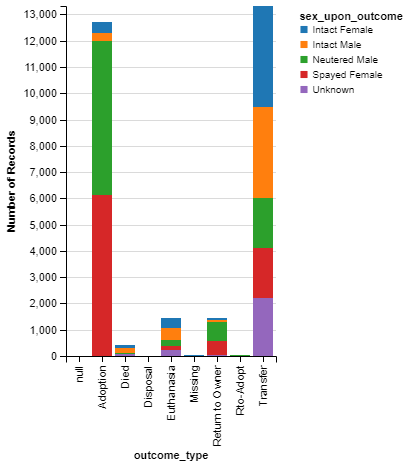

In [254]:
altair.Chart(originalcatdata, max_rows=100000).mark_bar().encode(x='outcome_type',color='sex_upon_outcome',y='count(*)')

This bar chart of the outcomes based on their sex upon outcome shows how that variable affects the outcome. (This was probably the most interesting chart I looked at.) Clearly, the cats that were adopted are much more likely to be neutered or spayed. The cats that were transfered are more likely not to be. It is tougher to see, but the neutered/spayed cats are also more commonly returned to their owner than those that are not.

## Best model with the original data

In [255]:
withoutoutcome = encodedcatdata.drop(columns=['outcome_type'])

In [256]:
outcomes = encodedcatdata[['outcome_type']]

In [257]:
q = np.array(withoutoutcome)

In [258]:
X_train, X_test, y_train, y_test = train_test_split(q,outcomes,test_size=0.2,random_state=4)

#### Random Forest

In [259]:
model_RR = RandomForestClassifier()

In [260]:
model_RR.fit(X_train, y_train)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:1: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  """Entry point for launching an IPython kernel.


RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

In [261]:
predRForiginal = model_RR.predict(X_test)

In [262]:
metrics.accuracy_score(y_test, predRForiginal)

0.7160577740016992

In [263]:
metrics.confusion_matrix(y_test, predRForiginal)

array([[2100,    2,    0,   13,    0,    0,   42,    1,  365],
       [  13,    4,    0,    2,    0,    0,    2,    0,   69],
       [   0,    0,    1,    1,    0,    0,    0,    0,    3],
       [  40,    5,    0,   35,    0,    0,   13,    0,  206],
       [   2,    0,    0,    0,    0,    0,    0,    0,    1],
       [   0,    0,    0,    0,    0,    0,    0,    0,    2],
       [ 158,    0,    0,   10,    0,    0,   25,    0,  103],
       [   3,    0,    0,    1,    0,    0,    0,    0,    1],
       [ 500,   10,    0,   61,    0,    0,   41,    1, 2049]])

In [264]:
print(classification_report(y_test, predRForiginal, target_names=['Adoption','Died','Disposal','Euthanasia','Missing',
                                                                  'No Outcome','Return to Owner','RTO-adopt','Transfer']))

                 precision    recall  f1-score   support

       Adoption       0.75      0.83      0.79      2523
           Died       0.19      0.04      0.07        90
       Disposal       1.00      0.20      0.33         5
     Euthanasia       0.28      0.12      0.17       299
        Missing       0.00      0.00      0.00         3
     No Outcome       0.00      0.00      0.00         2
Return to Owner       0.20      0.08      0.12       296
      RTO-adopt       0.00      0.00      0.00         5
       Transfer       0.73      0.77      0.75      2662

    avg / total       0.68      0.72      0.69      5885



/usr/local/lib/python3.5/site-packages/sklearn/metrics/classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


The random forest model gave the best prediction when using the original, label encoded data. Without altering anything, it was able to predict the outcome of a cat in the shelter with roughly 71-72% accuracy. The decision tree model produced the second highest accuracy, with about 70-71%. The KMeans model gave about 33.% accuracy. Without looking at the classification report, 71% seems to be a pretty good predictor. However, the classification report shows that this models predicts adoptions and transfers fairly well, but does a horrible job predicting the others. This shows that a transformation might be helpful in order to get a better model.

### Decision Tree

In [265]:
model_tree = DecisionTreeClassifier()

In [266]:
model_tree.fit(X_train, y_train)

DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best')

In [267]:
pred2 = model_tree.predict(X_test)

In [268]:
metrics.accuracy_score(pred2, y_test)

0.7109600679694138

In [269]:
confusion_matrix(pred2, y_test)

array([[2122,   15,    0,   48,    2,    0,  158,    3,  535],
       [   4,    6,    0,    6,    0,    0,    0,    0,   17],
       [   0,    0,    1,    1,    0,    0,    0,    0,    0],
       [  12,    2,    0,   40,    0,    0,    8,    1,   81],
       [   0,    1,    0,    0,    0,    0,    0,    0,    0],
       [   0,    0,    0,    0,    0,    0,    0,    0,    0],
       [  40,    0,    0,   12,    0,    0,   27,    1,   41],
       [   1,    0,    0,    0,    0,    0,    0,    0,    0],
       [ 344,   66,    4,  192,    1,    2,  103,    0, 1988]])

### KMeans

In [270]:
kmeans = KMeans(n_clusters=len(outcomelist), random_state=2).fit(q)

In [271]:
X_clustered = kmeans.fit_predict(X_test)

In [272]:
accuracy = accuracy_score(X_clustered, y_test)

In [273]:
accuracy

0.33135089209855567

In [274]:
confusion_matrix(X_clustered, y_test)

array([[1792,   72,    1,  116,    3,    2,   34,    2, 1574],
       [  58,    3,    0,   22,    0,    0,   17,    0,   23],
       [ 124,    2,    0,   41,    0,    0,   49,    1,  295],
       [  25,    1,    0,   18,    0,    0,   18,    0,   24],
       [  67,    0,    1,   21,    0,    0,   41,    1,   61],
       [  74,    1,    0,   11,    0,    0,   29,    0,   34],
       [  10,    0,    0,   10,    0,    0,    4,    0,   11],
       [ 275,    7,    3,   39,    0,    0,   60,    1,  508],
       [  98,    4,    0,   21,    0,    0,   44,    0,  132]])

### Finding Random Forest Mistakes

In [275]:
realrf = []
incorrectrf = []
for i in list(y_test['outcome_type']):
    if i != list(predRForiginal)[i]:
        realrf.append(i)
        incorrectrf.append(list(predRForiginal)[i])

In [276]:
realrf = pd.DataFrame(realrf)

In [277]:
realrf = realrf.rename(columns = {0:'real'})

In [278]:
incorrectrf = pd.DataFrame(incorrectrf)

In [279]:
incorrectrf = incorrectrf.rename(columns = {0:'predicted'})

In [280]:
randomforestmistakes = realrf.join(incorrectrf)

### Finding Decision Tree Mistakes

In [281]:
realdt = []
incorrectdt = []
for i in list(y_test['outcome_type']):
    if i != list(pred2)[i]:
        realdt.append(i)
        incorrectdt.append(list(pred2)[i])

In [282]:
realdt = pd.DataFrame(realdt)

In [283]:
realdt = realdt.rename(columns = {0:'real'})

In [284]:
incorrectdt = pd.DataFrame(incorrectdt)

In [285]:
incorrectdt = incorrectdt.rename(columns = {0:'predicted'})

In [286]:
decisiontreemistakes = realdt.join(incorrectdt)

### Finding KMeans Mistakes

In [287]:
real = []
incorrect = []
for i in list(y_test['outcome_type']):
    if i != list(X_clustered)[i]:
        real.append(i)
        incorrect.append(list(X_clustered)[i])

In [288]:
real = pd.DataFrame(real)

In [289]:
real = real.rename(columns = {0:'real'})

In [290]:
incorrect = pd.DataFrame(incorrect)

In [291]:
incorrect = incorrect.rename(columns = {0:'predicted'})

In [292]:
kmeansmistakes = real.join(incorrect)

In [293]:
'''
0: Adoption
1: Died
2: Disposal
3: Euthanasia
4: Missing
5: No Outcome
6: Return to Owner
7: Rto-Adopt
8: Transfer
'''

'\n0: Adoption\n1: Died\n2: Disposal\n3: Euthanasia\n4: Missing\n5: No Outcome\n6: Return to Owner\n7: Rto-Adopt\n8: Transfer\n'

#### Random Forest Pivot Table

In [294]:
pd.crosstab(randomforestmistakes.real,randomforestmistakes.predicted)

predicted,0,8
real,,
1,0,90
2,0,5
3,299,0
4,0,3
5,0,2
6,296,0
7,5,0


#### Decision Tree Pivot Table

In [295]:
pd.crosstab(decisiontreemistakes.real,decisiontreemistakes.predicted)

predicted,0,3,8
real,,,
1,0,90,0
2,0,0,5
3,299,0,0
4,0,0,3
5,2,0,0
6,296,0,0
7,5,0,0


#### KMeans Pivot Table

In [296]:
pd.crosstab(kmeansmistakes.real,kmeansmistakes.predicted)

predicted,0,3,7,8
real,,,,
1,0,0,0,90
2,5,0,0,0
3,299,0,0,0
4,0,0,3,0
5,0,2,0,0
6,296,0,0,0
7,5,0,0,0
8,2662,0,0,0


In my original project with data about cats from this humane society in Austin, Texas, I one hot encoded the origial dataset. This gave three models 100% accuracy with their predictions. Therefore, I decided to use the original dataset (without one hot encoding) in order to explore what it predicted incorrectly. I used the three best models from my original predictions. The random forest appears to have predicted transfer 90 times when the cat actually died on its own. It predicted 5 transfers when a disposal happened, 299 adoptions when a euthanization happened, 3 transfers when a cat went missing, 2 adoptions when there wasn't an outcome, 296 adoptions when it was returned to its owner, and 5 adoptions when it should have been rto-adopt. The decision tree appears to have almost the same results, except it predicted euthanasia 90 times when there was an adoption. Kmeans clearly had the most incorrect predictions. It says there were 90 transfers when the cat died, 5 adoptions when disposal was the result, 299 adoptions when the cat was euthanized, 3 rto-adoptions when the cat went missing, 2 euthanasias when there was no outcome, 296 adoptions when the cat was returned to its owner, 5 adoptions when it was an rto-adoption, and 2662 adoptions when the result was a transfer. Since all the variables are categorial, there really aren't any additional variables that needed to be added.

## Grid Search

In [304]:
param_grid = {
    'bootstrap': [True, False],
    'max_depth': [80,100,150],
    'max_features':[2,3,5],
    'min_samples_leaf':[3,4,5,10],
    'min_samples_split':[8,10,12,20],
    'n_estimators':[10,100,300,1000]}

grid_search = GridSearchCV(estimator = model_RR, param_grid = param_grid, cv = 3, n_jobs = -1, verbose = 2)

In [305]:
grid_search.fit(X_train, y_train)

Fitting 3 folds for each of 1152 candidates, totalling 3456 fits


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_split.py:605: Warning: The least populated class in y has only 1 members, which is too few. The minimum number of members in any class cannot be less than n_splits=3.
  % (min_groups, self.n_splits)), Warning)


[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.0s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.0s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   6.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   5.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   6.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.1s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   5.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   6.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   6.5s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   1.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   6.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   7.0s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   7.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   6.2s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   3.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  13.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   6.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  13.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.3s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  11.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.3s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   3.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  12.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   7.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   3.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   3.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  21.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  21.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  21.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  23.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  23.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  21.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  21.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   6.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  21.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  21.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   3.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  12.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  12.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   5.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  21.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   5.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  20.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
[Parallel(n_jobs=-1)]: Done 114 tasks      | elapsed:   37.9s


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  22.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   3.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   7.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.4s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  12.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  22.1s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  23.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   5.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  11.9s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   3.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   3.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   1.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  22.9s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   6.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   3.3s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   3.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   5.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  11.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   3.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  21.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  20.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  19.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  19.7s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  11.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   3.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   3.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  11.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   3.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   3.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  20.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  21.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   3.4s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   5.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  21.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  20.2s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  22.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   4.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   4.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   3.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  10.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  18.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  20.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  10.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   7.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  10.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  20.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  23.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   4.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   7.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  20.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   8.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  19.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   4.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  22.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   8.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  19.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  21.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  15.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   4.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   8.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   8.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  20.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  14.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   4.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   8.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   8.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   3.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  14.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   4.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   7.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  25.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  25.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  13.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   7.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  14.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  25.9s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   4.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  25.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  25.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  25.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   4.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  25.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  25.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  27.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  24.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   4.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   4.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  14.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   7.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   6.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  25.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  25.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


[Parallel(n_jobs=-1)]: Done 317 tasks      | elapsed:  1.9min
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  25.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   4.6s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  14.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  15.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  24.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  26.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   6.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  26.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  23.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   4.7s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.3s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   6.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  25.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  22.5s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   4.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  16.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  16.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   4.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   4.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   6.6s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  23.9s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  23.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  15.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  25.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   4.7s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   4.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  14.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   3.2s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  15.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   3.8s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  15.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   7.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  21.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  24.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   6.3s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  22.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   9.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   9.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  21.1s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  20.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  20.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   9.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  14.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  19.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   9.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  15.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  15.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  20.4s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  21.3s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   9.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   8.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.5s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   8.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   9.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  21.7s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   8.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   8.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.4s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  22.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   8.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  23.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  22.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   8.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   8.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   6.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   3.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  21.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   8.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   3.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  28.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  21.6s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  29.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   3.0s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   3.2s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   6.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  20.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  28.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   8.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  22.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  30.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  27.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  30.9s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   8.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   9.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   3.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   6.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  29.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   7.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   9.0s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  20.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  21.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  29.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  29.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  30.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  20.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  20.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   8.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   6.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   8.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   8.4s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   6.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   6.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  28.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  21.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   5.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  28.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   6.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=True, total=   7.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  20.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   5.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   8.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=True, total=   8.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  28.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  28.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   5.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.5s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  21.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=True, total=   2.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=True, total=   8.0s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  28.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  20.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  31.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   5.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   6.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  27.9s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=True, total=   8.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  20.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  30.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  19.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   6.2s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   5.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  20.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   4.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  28.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.1s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  29.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  26.2s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=True, total=  27.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  19.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.9s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
[Parallel(n_jobs=-1)]: Done 600 tasks      | elapsed:  3.8min


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  19.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   4.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   4.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.5s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   3.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   5.9s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=True, total=  26.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   5.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  20.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   6.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=True, total=  25.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  15.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   4.4s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   4.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   4.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  20.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  15.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  21.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   4.0s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   6.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  27.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=True, total=  28.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   4.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  14.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  15.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   5.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  21.5s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  21.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  19.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   6.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.6s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  14.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  20.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  20.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  19.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   6.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.3s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  14.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  14.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   5.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  19.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   5.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   6.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  20.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.0s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.9s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  14.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  14.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  19.6s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   5.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   5.7s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   5.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.4s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  14.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  14.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.1s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   5.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  14.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  21.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   5.7s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  19.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   5.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   5.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   3.9s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   3.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  18.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   5.8s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.3s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  18.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  13.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  13.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.8s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   3.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   3.9s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   5.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  13.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  19.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  19.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  20.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  18.6s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  12.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  13.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.3s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.8s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  18.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   5.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  13.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  13.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  19.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   7.2s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   5.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  18.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   7.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   5.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   7.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.9s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  19.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  13.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   5.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  13.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  16.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   7.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   6.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  18.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  17.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.9s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   7.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  18.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   7.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   6.1s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  17.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  18.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  18.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   6.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   7.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   5.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   5.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  18.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   6.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   4.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  17.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   7.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   6.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  24.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  25.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  23.1s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  23.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.3s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  16.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  17.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   7.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   4.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   4.1s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  23.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  22.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  23.6s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   4.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  22.4s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   7.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   6.5s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   5.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  16.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  17.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  17.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  21.9s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  22.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.4s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   5.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  24.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  16.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   5.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  16.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   7.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   5.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   4.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   4.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  23.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   5.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   4.7s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   4.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  16.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  22.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   4.6s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  23.4s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   4.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  23.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  21.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.5s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  16.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  15.5s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  23.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  22.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  21.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   3.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   6.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  23.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  15.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  21.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  15.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   3.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  21.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


[Parallel(n_jobs=-1)]: Done 965 tasks      | elapsed:  6.0min
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  21.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   6.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  24.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   6.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  15.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   3.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   9.4s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   6.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  22.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   8.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  14.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  15.2s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   9.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.9s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  20.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   6.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  22.4s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   8.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   9.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  21.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   8.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   9.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   6.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   9.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   8.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   3.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  22.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  21.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   8.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   3.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  21.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   9.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   9.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=  10.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  21.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  21.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  21.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  32.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   9.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   8.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  21.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  30.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  30.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   6.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   6.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   3.6s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  21.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  30.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  29.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  21.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   9.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   7.7s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   6.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   3.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   8.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  29.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  20.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  29.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  21.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  29.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   6.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  30.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   9.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   8.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   3.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   8.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   6.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   8.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  29.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.3s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  20.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  21.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   5.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=True, total=   2.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  26.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  20.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   7.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=True, total=   8.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  29.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  29.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   6.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   6.0s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  20.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  28.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  21.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  20.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  26.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   7.6s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=True, total=   8.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   6.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  21.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  30.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   6.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=True, total=   8.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  24.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  26.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   4.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  19.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  27.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  27.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   4.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=True, total=  28.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  18.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  26.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=True, total=  27.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  14.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  20.0s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=True, total=  20.0s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   4.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   6.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  26.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  26.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  15.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  19.7s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   4.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=True, total=  27.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  21.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   6.8s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.8s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   4.1s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  15.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   5.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   5.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  22.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  22.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   5.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   5.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  15.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.2s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   4.0s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   5.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.3s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  21.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   6.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  22.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  14.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  14.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  15.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.9s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  20.4s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  20.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   6.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  14.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   6.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.9s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   4.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   4.3s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   5.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  14.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  19.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   5.4s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  13.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  19.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   5.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  14.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   1.6s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   1.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   3.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  20.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  20.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  14.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   3.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   4.9s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  19.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   5.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  14.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   3.7s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   3.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   4.9s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.0s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  18.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  13.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  20.8s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.0s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.0s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   3.9s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  18.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   3.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   5.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  19.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   3.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.6s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  12.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  12.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  12.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   5.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  19.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   5.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  19.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  17.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  12.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  13.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  19.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  18.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   5.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   5.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   6.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  12.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.5s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  18.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   7.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  12.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   7.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   5.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   1.7s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   1.6s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  17.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   7.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   7.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  18.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   5.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  17.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   6.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   7.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  18.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   4.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   5.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  17.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   7.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  17.6s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   5.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  17.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  16.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   7.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   7.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


[Parallel(n_jobs=-1)]: Done 1410 tasks      | elapsed:  8.8min
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  17.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   5.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   5.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  23.7s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  23.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.1s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  17.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   6.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  23.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   5.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.4s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  24.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   6.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   4.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   1.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  22.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  22.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   7.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.4s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   7.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  22.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   5.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  22.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  16.1s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  23.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   6.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   6.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.2s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  16.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  17.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  22.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  22.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  23.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   5.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  16.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  16.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  16.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   6.7s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   5.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   5.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   7.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   4.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   4.7s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   4.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.5s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  16.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  16.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   4.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  22.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  23.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  23.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   7.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   4.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   4.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   4.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  16.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  22.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   4.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  15.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  21.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   6.3s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   6.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.4s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  21.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  20.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   3.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   3.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  22.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  23.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   6.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   6.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  20.4s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  20.5s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  14.5s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  15.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   8.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  14.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  20.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  21.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  22.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.2s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   9.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  15.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  15.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   8.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.1s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   9.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   9.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   9.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   8.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  21.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   8.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   8.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   6.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  22.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   9.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  22.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   8.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   8.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  20.7s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   8.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  21.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   6.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  29.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.5s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   8.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   3.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  21.4s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  21.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  29.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.0s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   3.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  30.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   6.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  21.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  31.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  29.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   8.3s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  28.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  21.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   8.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   9.1s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  29.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  21.2s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   8.3s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  29.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   6.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   9.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   3.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  29.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  29.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  20.1s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   7.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  21.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   9.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.0s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   9.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  29.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   3.0s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   6.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   8.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=True, total=   2.9s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   8.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  21.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  20.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  29.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.6s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   2.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   5.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=True, total=   3.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=True, total=   0.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   1.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  20.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  28.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  21.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=True, total=   8.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=True, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   6.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=True, total=   8.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   1.9s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=True, total=   2.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  20.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   5.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  30.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   6.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  28.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=True, total=   7.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  20.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   1.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   3.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   5.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   6.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=True, total=   8.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  27.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   5.1s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  19.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   5.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  30.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   9.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  29.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  25.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   5.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   5.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=True, total=  26.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  29.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   5.6s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  19.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   1.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  26.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  19.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  26.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=True, total=  28.1s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  19.6s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   5.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   5.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=True, total=  19.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  25.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   7.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   5.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=True, total=  27.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   7.1s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  18.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.6s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   7.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   5.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   5.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   7.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   1.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  18.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   4.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   7.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  25.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   7.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  25.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   4.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  17.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   5.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.6s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  24.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   7.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  26.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  17.6s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   5.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   5.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.2s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  16.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.2s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  17.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   7.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   1.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  25.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   1.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  26.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   6.9s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   5.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  18.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  24.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  25.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   7.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   1.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  24.6s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   5.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  17.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  17.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   7.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   7.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   1.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   1.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  25.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   7.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.2s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  17.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  24.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   7.0s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   7.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  22.6s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   5.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   1.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   6.7s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  17.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   7.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   6.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  23.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   6.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  17.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  24.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   6.9s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  16.9s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   4.7s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   1.7s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  24.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  24.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  16.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   7.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  17.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   6.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   1.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   5.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  23.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   6.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   6.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  16.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  16.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   4.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   5.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   3.1s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  15.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  22.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   6.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  16.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   3.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   6.7s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  23.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  22.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   9.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  15.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  15.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  20.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   8.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


[Parallel(n_jobs=-1)]: Done 1937 tasks      | elapsed: 12.3min
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  19.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   9.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   9.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  22.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   6.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  21.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  20.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   9.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.1s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   8.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  20.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  20.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   9.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   9.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   8.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   3.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  22.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  21.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  22.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  20.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   8.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  21.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  22.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   8.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   9.0s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   8.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   6.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   6.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  21.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  21.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   5.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   6.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   9.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  21.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   6.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  29.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  31.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  26.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   6.3s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  29.8s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  21.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   6.0s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   6.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  20.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  29.0s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  30.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   9.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   5.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   6.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   7.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.2s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  28.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  30.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  18.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  28.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  27.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  19.9s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   6.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  20.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   7.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   1.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  27.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  29.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.5s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   5.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.2s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   7.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   7.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  30.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  20.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   5.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.8s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   6.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  20.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.8s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  26.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  27.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   8.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  19.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   8.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  19.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   8.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  20.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   3.6s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  27.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   7.5s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   7.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   7.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   4.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  29.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  18.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  19.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   3.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   3.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   4.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  26.1s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  18.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  26.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  18.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=  11.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  27.0s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  19.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=  12.5s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  22.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   5.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  17.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=  11.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=  11.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   3.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   3.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   3.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=  12.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   3.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   8.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   4.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   3.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  23.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=  11.3s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=  12.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=  10.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  26.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=  12.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   3.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   4.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   3.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   8.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  28.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=  12.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  28.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=  12.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=  11.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=  11.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  29.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  29.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=  11.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   8.3s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  28.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   8.4s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  28.6s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   4.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  27.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  39.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=  10.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   4.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  37.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   7.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=  10.6s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  28.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  39.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   4.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=  10.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  37.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  39.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=  12.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   4.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  27.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  39.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=  10.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  40.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  37.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   3.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   4.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  39.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   8.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  39.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  27.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  27.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=  11.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  27.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=  11.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=80, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=  10.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=80, bootstrap=False, total=   0.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   8.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  37.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  28.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  38.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   3.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   7.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=80, bootstrap=False, total=   3.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   7.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=80, bootstrap=False, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=  12.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=80, bootstrap=False, total=   9.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  27.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=80, bootstrap=False, total=   3.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  28.0s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=   7.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  37.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=80, bootstrap=False, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  36.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=  10.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=80, bootstrap=False, total=  12.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   3.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   7.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=80, bootstrap=False, total=   4.0s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=   7.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False 
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  27.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=80, bootstrap=False, total=  10.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   1.9s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  37.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=   7.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=  11.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  25.8s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  25.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  37.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   5.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   7.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=80, bootstrap=False, total=  11.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  37.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  25.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   5.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  37.2s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  26.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  38.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  38.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=80, bootstrap=False, total=  36.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   7.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   8.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  25.9s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   5.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   5.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=80, bootstrap=False, total=  33.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   7.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  26.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  18.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   7.0s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  26.5s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   7.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  34.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   7.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   5.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   5.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  18.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   7.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  18.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=80, bootstrap=False, total=  37.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  25.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=80, bootstrap=False, total=  34.9s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  17.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  25.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   5.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   7.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   7.0s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   1.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   7.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  18.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  26.3s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   7.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   7.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   6.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  26.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   7.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   6.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  25.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  17.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  18.0s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   5.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  24.7s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   6.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  16.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  25.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  18.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   6.7s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   4.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  24.6s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   6.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   5.1s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  17.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  17.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   1.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.4s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   5.0s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  23.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   7.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  17.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   7.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   1.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  18.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.1s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   5.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   5.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   1.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   1.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  24.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   4.1s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   8.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   6.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   5.9s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  22.8s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   4.8s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   4.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   1.9s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  17.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   6.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  23.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  23.4s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  17.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  23.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  21.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   4.7s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   4.7s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  22.1s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  16.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  17.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   6.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  15.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   4.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  15.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   3.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  22.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   5.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  23.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   6.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  15.3s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  21.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.1s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   6.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   3.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.3s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  21.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   8.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   8.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  19.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  15.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  22.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   9.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   8.9s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   9.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  14.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  15.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   6.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   8.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  20.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  20.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   9.2s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   6.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  21.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   8.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   6.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   9.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


[Parallel(n_jobs=-1)]: Done 2544 tasks      | elapsed: 16.9min
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  22.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  22.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   9.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  22.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  22.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   8.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   8.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   9.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  21.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   6.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   6.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  29.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  26.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  30.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   6.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   6.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   8.1s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  21.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  22.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  30.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  29.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  28.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  30.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  21.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  21.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  27.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   9.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   8.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   3.1s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   6.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  20.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   8.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   6.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  20.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  21.0s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  31.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   8.4s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   8.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   5.9s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  29.1s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   7.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  29.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   8.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  20.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  20.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   5.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  29.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   7.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   7.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  20.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   1.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   5.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   7.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   7.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  28.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  20.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   5.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  19.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  27.6s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   7.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  28.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   6.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   5.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  18.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   3.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  28.0s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  19.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   3.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   8.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  29.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  25.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  26.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  19.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   3.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  19.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.5s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   3.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   3.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  25.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=  10.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  18.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   8.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   4.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   4.0s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=  11.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   4.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.6s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   8.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  19.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=  10.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  26.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   3.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   3.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   3.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   8.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=  12.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  25.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=  10.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   4.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   4.3s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=  11.4s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  25.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  25.1s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  27.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   3.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=  11.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   3.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   8.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=  10.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  27.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  28.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  29.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=  11.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   8.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   4.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=  10.3s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=  12.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  29.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   3.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   3.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   3.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  28.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  28.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   8.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  37.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  37.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=  11.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   4.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  36.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=  10.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  27.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=  12.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   3.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  37.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  36.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   3.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  38.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=  11.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=  11.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   3.6s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   3.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   3.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  37.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   8.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  26.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  28.2s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  40.4s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  28.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  36.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.3s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=  12.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   3.4s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  37.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  38.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=  11.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  27.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  27.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   3.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=100, bootstrap=False, total=   3.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=  11.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   8.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=100, bootstrap=False, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=  12.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  27.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  27.7s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=100, bootstrap=False, total=   3.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   7.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=  11.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=100, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=   8.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  37.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=100, bootstrap=False, total=  10.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   7.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=100, bootstrap=False, total=   3.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=   7.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=100, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  35.6s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=100, bootstrap=False, total=  11.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=   7.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   3.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=100, bootstrap=False, total=   4.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  26.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=  10.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=100, bootstrap=False, total=  10.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  36.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  26.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  36.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  27.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  38.4s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   7.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.4s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=   8.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  35.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=100, bootstrap=False, total=  10.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  37.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   5.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  25.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   6.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  25.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  35.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   5.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   5.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  32.5s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  34.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  26.1s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   1.8s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  26.0s
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=100, bootstrap=False, total=  36.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   5.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   7.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   7.0s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   1.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=100, bootstrap=False, total=  35.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   5.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   5.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   5.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  18.5s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  26.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=100, bootstrap=False, total=  34.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   1.7s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   5.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   7.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   7.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  17.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  24.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   5.1s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   5.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.2s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   5.4s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  18.1s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  25.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  18.3s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  36.6s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=100, bootstrap=False, total=  36.9s
[CV] min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  25.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   5.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.2s
[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  25.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   5.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   7.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   1.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   4.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   4.9s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   5.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  17.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   1.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  26.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   5.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  23.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  24.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   5.0s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  16.9s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  26.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   7.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   1.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  18.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  22.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   5.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  24.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   5.1s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  17.4s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   1.8s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   7.6s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   5.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   6.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  25.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   7.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   1.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   4.9s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   5.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   7.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  24.7s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  16.6s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  17.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  25.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   5.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   4.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   1.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  23.8s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  16.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  23.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   6.4s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  25.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   4.6s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   1.5s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.0s
[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  22.8s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  17.0s
[CV] min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  17.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   5.8s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   6.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   1.6s
[CV] min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   6.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  23.0s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   6.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  16.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   5.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  22.7s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   4.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  15.0s
[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   6.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  16.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   6.2s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  23.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  15.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   3.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  15.4s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  24.3s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   3.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  23.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  20.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.5s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  15.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   6.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  15.8s
[CV] min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  21.2s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   9.7s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  15.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   1.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  20.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   6.4s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.9s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  19.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   8.7s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=2, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  22.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   3.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   3.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   8.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   6.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  22.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  22.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  22.1s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  21.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   9.6s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.0s
[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  21.4s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   6.5s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  30.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  21.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  21.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  29.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   5.7s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   6.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.2s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  28.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  29.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  21.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   5.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=3, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  28.8s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   6.5s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  27.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   3.6s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   6.2s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  29.9s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   9.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  21.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  21.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.9s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   6.4s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  29.0s
[CV] min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  29.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  28.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   3.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  19.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  20.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   5.1s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.0s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   9.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   6.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   1.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  28.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   5.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.7s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   8.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   5.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  20.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  20.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  27.5s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  20.8s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   6.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   6.9s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  27.1s
[CV] min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
[Parallel(n_jobs=-1)]: Done 3233 tasks      | elapsed: 22.1min


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   7.5s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  27.7s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  19.6s
[CV] min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  28.3s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.0s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.3s
[CV] min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   6.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   7.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   7.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   5.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  21.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   6.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   7.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   4.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  28.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  19.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  29.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  26.5s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  20.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   4.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   4.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   4.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.5s
[CV]  min_samples_leaf=5, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  27.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.2s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  25.1s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  26.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=  11.9s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  18.8s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  19.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   3.8s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   9.3s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   4.0s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  24.1s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  19.6s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=3, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  26.7s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  19.2s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=  12.3s
[CV] min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   3.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   4.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=  11.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   7.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=  10.6s
[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  24.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   8.4s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=  12.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=3, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  26.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=  11.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   3.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   3.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   4.5s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   9.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.4s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=  11.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  29.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=  11.6s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   4.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=  11.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  28.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=  11.9s
[CV] min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.3s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.6s
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  28.2s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   4.0s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  28.7s
[CV] min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  39.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  40.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  28.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  37.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  37.5s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   8.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   8.3s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  27.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  39.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  36.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.9s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  27.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   8.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=3, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  38.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=  11.6s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   8.1s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  38.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  37.9s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   7.6s
[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.7s
[CV] min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.8s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   3.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=  12.1s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   3.5s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  36.4s
[CV] min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.0s
[CV] min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   8.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  38.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=8, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=  11.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  26.6s
[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  27.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   4.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  35.9s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=8, max_depth=150, bootstrap=False, total=   3.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   8.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  37.8s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=10, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=  11.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  39.0s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   2.6s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=  10.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   3.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   7.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   7.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=8, max_depth=150, bootstrap=False, total=   7.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=10, max_depth=150, bootstrap=False, total=   3.1s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=12, max_depth=150, bootstrap=False, total=   0.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=4, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  36.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  27.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   2.2s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  27.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   3.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=12, max_depth=150, bootstrap=False, total=   3.5s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=   7.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  36.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.4s
[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 
[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  26.8s


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV] min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.4s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=10, min_samples_split=20, max_depth=150, bootstrap=False, total=   0.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  37.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=8, max_depth=150, bootstrap=False, total=  36.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=  11.3s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=12, max_depth=150, bootstrap=False, total=  27.7s
[CV] min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=10, max_depth=150, bootstrap=False, total=  11.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   2.6s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   7.8s
[CV] min_samples_leaf=10, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False 


/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_validation.py:458: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)


[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   7.1s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   3.6s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=12, max_depth=150, bootstrap=False, total=   7.4s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=100, min_samples_split=20, max_depth=150, bootstrap=False, total=   4.0s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=10, max_depth=150, bootstrap=False, total=  37.1s
[CV]  min_samples_leaf=5, max_features=5, n_estimators=1000, min_samples_split=20, max_depth=150, bootstrap=False, total=  26.7s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150, bootstrap=False, total=   6.4s
[CV]  min_samples_leaf=10, max_features=5, n_estimators=300, min_samples_split=20, max_depth=150,

[Parallel(n_jobs=-1)]: Done 3456 out of 3456 | elapsed: 24.3min finished
/usr/local/lib/python3.5/site-packages/sklearn/model_selection/_search.py:739: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  self.best_estimator_.fit(X, y, **fit_params)


GridSearchCV(cv=3, error_score='raise',
       estimator=RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False),
       fit_params=None, iid=True, n_jobs=-1,
       param_grid={'min_samples_leaf': [3, 4, 5, 10], 'max_features': [2, 3, 5], 'min_samples_split': [8, 10, 12, 20], 'max_depth': [80, 100, 150], 'n_estimators': [10, 100, 300, 1000], 'bootstrap': [True, False]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=2)

In [307]:
grid_search.best_params_

{'bootstrap': False,
 'max_depth': 80,
 'max_features': 2,
 'min_samples_leaf': 10,
 'min_samples_split': 8,
 'n_estimators': 10}

In [309]:
randfor = RandomForestClassifier(bootstrap=False, max_depth=80, max_features=2, min_samples_leaf=10, min_samples_split=8,
                                n_estimators=10).fit(X_train,y_train)

/usr/local/lib/python3.5/site-packages/ipykernel_launcher.py:2: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  


In [310]:
randforpred = randfor.predict(X_test)

In [311]:
metrics.accuracy_score(y_test, randforpred)

0.729141886151232

In [313]:
metrics.confusion_matrix(y_test, randforpred)

array([[2368,    0,    0,    0,    0,    0,    0,    0,  155],
       [   9,    0,    0,    0,    0,    0,    0,    0,   81],
       [   0,    0,    0,    0,    0,    0,    0,    0,    5],
       [  66,    0,    0,    1,    0,    0,    0,    0,  232],
       [   2,    0,    0,    0,    0,    0,    0,    0,    1],
       [   0,    0,    0,    0,    0,    0,    0,    0,    2],
       [ 251,    0,    0,    0,    0,    0,    1,    0,   44],
       [   5,    0,    0,    0,    0,    0,    0,    0,    0],
       [ 741,    0,    0,    0,    0,    0,    0,    0, 1921]])

In [322]:
print(classification_report(y_test, randforpred, target_names=['Adoption','Died','Disposal','Euthanasia','Missing',
                                                                  'No Outcome','Return to Owner','RTO-adopt','Transfer']))

                 precision    recall  f1-score   support

       Adoption       0.69      0.94      0.79      2523
           Died       0.00      0.00      0.00        90
       Disposal       0.00      0.00      0.00         5
     Euthanasia       1.00      0.00      0.01       299
        Missing       0.00      0.00      0.00         3
     No Outcome       0.00      0.00      0.00         2
Return to Owner       1.00      0.00      0.01       296
      RTO-adopt       0.00      0.00      0.00         5
       Transfer       0.79      0.72      0.75      2662

    avg / total       0.75      0.73      0.68      5885



/usr/local/lib/python3.5/site-packages/sklearn/metrics/classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)


After the grid search, the random forest prediction did improve. However, it improved because the model just predicted either transfer or adoption more often because those were the most common outcomes by far. Even though this is the case, it is good that the grid search caused a better prediction.

## Ensemble Method

In [417]:
new_y_test = y_test.reset_index()

In [418]:
ensemble = pd.concat([pd.DataFrame(X_test),new_y_test], axis=1)

In [419]:
ensemble = ensemble[[0,1,2,3,4,5,6,7,8,9,10,'outcome_type']]

In [420]:
ensemble = pd.concat([ensemble,pd.DataFrame(predRForiginal),pd.DataFrame(randforpred),pd.DataFrame(pred2),
                      pd.DataFrame(X_clustered)], axis=1)

In [421]:
columnnames = list(ensemble.columns[:-4])

In [422]:
columnnames.append('rand_for')
columnnames.append('rand_for_grid')
columnnames.append('tree')
columnnames.append('km')

In [423]:
ensemble.columns = columnnames

In [424]:
ensemble.head()

,0,1,2,3,4,5,6,7,8,9,10,outcome_type,rand_for,rand_for_grid,tree,km
0,60,26,0,0,0,17,0,1,7,0,18,0,0,8,0,0
1,1460,17,1,1,0,15,0,1,0,2,18,8,8,8,3,8
2,21,26,4,0,1,17,0,1,7,0,0,8,8,8,8,0
3,60,26,3,0,1,17,0,1,6,9,18,8,0,0,0,0
4,300,22,3,0,1,16,0,1,8,0,0,8,8,0,8,7


In [427]:
ot = list(ensemble['outcome_type'])
rf = list(ensemble['rand_for'])
rfg = list(ensemble['rand_for_grid'])
tree = list(ensemble['tree'])
km = list(ensemble['km'])

In [430]:
correctpred = []
wrongpred = []
for i in ot:
    if i == rf[i] or i == rfg[i] or i == tree[i] or i == km[i]:
        correctpred.append(i)
    else:
        wrongpred.append(i)

In [436]:
ensembleaccuracy = len(correctpred) / (len(correctpred)+len(wrongpred))

In [437]:
ensembleaccuracy

0.881053525913339

The accuracy score for the ensemble method is roughly 88%. This is a big improvement for each of the models. This makes sense because it uses correct predictions from each of the four methods used.